In [48]:
import geopandas as gpd
import numpy as np

import pdal
import open3d

import rasterio
import pandas as pd
from shapely import wkt


In [2]:
#algorithms have to be great 

#probe data and VPD are 2 weeks data 

#traceid we should groupby it do we can get each trace independently 



In [2]:
pd.read_csv("data/VPD_descriptions.csv")

,Column,Type,Extra,Comment
0,driveid,varchar,NaN,Unique ID for the drive as given by provider
1,lengthm,real,NaN,Length of path in meters
2,rawsizebytes,integer,NaN,Size of the raw RSD data in bytes
3,fused,boolean,NaN,"If True, path column contains fused path. Else..."
4,hometile14,bigint,NaN,Level 14 HERE Tile in which the drive path starts
5,tilesl14,array(bigint),NaN,List of level 14 HERE Tiles the path intersects
6,signcount,integer,NaN,No. of signs recorded in the drive
7,dirsigncount,integer,NaN,No. of highway directional signs recorded in t...
8,polecount,integer,NaN,No. of poles recorded in the drive
9,trafficsignalcount,integer,NaN,No. of traffic signals recorded in the drive


In [4]:


# vpd_data = pd.read_csv("data/Kosovo_VPD/Kosovo_VPD.csv")
# vpd_data


In [58]:
prob_data = pd.read_csv("data/Kosovo_HPD/XKO_HPD_week_2.csv")
prob_data["time"] = pd.to_datetime(prob_data["time"], format="%H:%M:%S")

prob_data = prob_data.sort_values(by=['traceid', 'time']).reset_index(drop=True)


import movingpandas as mpd
from shapely.geometry import Point
from datetime import timedelta

# 1. Create a GeoDataFrame
prob_data['geometry'] = [Point(xy) for xy in zip(prob_data.longitude, prob_data.latitude)]
gdf = gpd.GeoDataFrame(prob_data, crs="EPSG:4324") # Standard


traj_collection = mpd.TrajectoryCollection(gdf.to_crs("EPSG:3857"), 'traceid', t='time')

traj_collection

TrajectoryCollection with 3053 trajectories

In [21]:
from tqdm import tqdm

In [23]:
(gdf.geometry.x/5).astype(int)

0         4
1         4
2         4
3         4
4         4
         ..
299068    4
299069    4
299070    4
299071    4
299072    4
Length: 299073, dtype: int64

In [59]:
gdf = gdf.to_crs("EPSG:3857")

In [60]:
gdf

,heading,latitude,longitude,traceid,speed,day,time,geometry
0,294.0,42.619358,21.082787,0028c34d5cb73401fc71e49101b153ba,6.0,7,1900-01-01 14:27:16,POINT (2346950.239 5254214.767)
1,28.0,42.621628,21.082846,0028c34d5cb73401fc71e49101b153ba,8.0,7,1900-01-01 14:31:18,POINT (2346956.818 5254558.125)
2,32.0,42.621770,21.082954,0028c34d5cb73401fc71e49101b153ba,2.0,7,1900-01-01 14:31:35,POINT (2346968.919 5254579.638)
3,34.0,42.621845,21.083015,0028c34d5cb73401fc71e49101b153ba,10.0,7,1900-01-01 14:31:50,POINT (2346975.709 5254591.014)
4,58.0,42.623280,21.084860,0028c34d5cb73401fc71e49101b153ba,34.0,7,1900-01-01 14:32:19,POINT (2347181.049 5254808.077)
...,...,...,...,...,...,...,...,...
299068,227.0,42.659297,21.157099,ffb6f68938392aa350abfe2105bd0d57,29.0,4,1900-01-01 17:09:58,POINT (2355222.614 5260258.443)
299069,134.0,42.659023,21.157169,ffb6f68938392aa350abfe2105bd0d57,13.0,4,1900-01-01 17:10:09,POINT (2355230.407 5260217.049)
299070,183.0,42.658780,21.157285,ffb6f68938392aa350abfe2105bd0d57,9.0,4,1900-01-01 17:10:20,POINT (2355243.318 5260180.223)
299071,108.0,42.658755,21.157402,ffb6f68938392aa350abfe2105bd0d57,NaN,4,1900-01-01 17:10:31,POINT (2355256.409 5260176.461)


In [61]:
cell_size = 1
gdf['grid_x'] = (gdf.geometry.x / cell_size).astype(int)
gdf['grid_y'] = (gdf.geometry.y / cell_size).astype(int)
gdf['cell_id'] = gdf['grid_x'].astype(str) + "_" + gdf['grid_y'].astype(str)


gdf

,heading,latitude,longitude,traceid,speed,day,time,geometry,grid_x,grid_y,cell_id
0,294.0,42.619358,21.082787,0028c34d5cb73401fc71e49101b153ba,6.0,7,1900-01-01 14:27:16,POINT (2346950.239 5254214.767),2346950,5254214,2346950_5254214
1,28.0,42.621628,21.082846,0028c34d5cb73401fc71e49101b153ba,8.0,7,1900-01-01 14:31:18,POINT (2346956.818 5254558.125),2346956,5254558,2346956_5254558
2,32.0,42.621770,21.082954,0028c34d5cb73401fc71e49101b153ba,2.0,7,1900-01-01 14:31:35,POINT (2346968.919 5254579.638),2346968,5254579,2346968_5254579
3,34.0,42.621845,21.083015,0028c34d5cb73401fc71e49101b153ba,10.0,7,1900-01-01 14:31:50,POINT (2346975.709 5254591.014),2346975,5254591,2346975_5254591
4,58.0,42.623280,21.084860,0028c34d5cb73401fc71e49101b153ba,34.0,7,1900-01-01 14:32:19,POINT (2347181.049 5254808.077),2347181,5254808,2347181_5254808
...,...,...,...,...,...,...,...,...,...,...,...
299068,227.0,42.659297,21.157099,ffb6f68938392aa350abfe2105bd0d57,29.0,4,1900-01-01 17:09:58,POINT (2355222.614 5260258.443),2355222,5260258,2355222_5260258
299069,134.0,42.659023,21.157169,ffb6f68938392aa350abfe2105bd0d57,13.0,4,1900-01-01 17:10:09,POINT (2355230.407 5260217.049),2355230,5260217,2355230_5260217
299070,183.0,42.658780,21.157285,ffb6f68938392aa350abfe2105bd0d57,9.0,4,1900-01-01 17:10:20,POINT (2355243.318 5260180.223),2355243,5260180,2355243_5260180
299071,108.0,42.658755,21.157402,ffb6f68938392aa350abfe2105bd0d57,NaN,4,1900-01-01 17:10:31,POINT (2355256.409 5260176.461),2355256,5260176,2355256_5260176


In [62]:
centroids = gdf.groupby('cell_id').agg({
    'geometry': lambda x: Point(x.x.median(), x.y.median())
}).reset_index()
centroids

cell_to_point = dict(zip(centroids['cell_id'], centroids['geometry']))

gdf = gdf.sort_values(['traceid', 'time'])
gdf['prev_cell'] = gdf.groupby('traceid')['cell_id'].shift(1)

moves = gdf[gdf['cell_id'] != gdf['prev_cell']].dropna(subset=['prev_cell'])
cell_to_point

{'2346947_5254268': <POINT (2346947.747 5254268.789)>,
 '2346947_5254576': <POINT (2346947.899 5254576.594)>,
 '2346947_5254594': <POINT (2346947.736 5254594.337)>,
 '2346947_5254603': <POINT (2346947.899 5254603.14)>,
 '2346947_5254639': <POINT (2346947.878 5254639.8)>,
 '2346947_5260116': <POINT (2346947.883 5260116.95)>,
 '2346947_5260341': <POINT (2346947.899 5260341.813)>,
 '2346948_5254157': <POINT (2346948.113 5254157.57)>,
 '2346948_5254169': <POINT (2346948.391 5254169.672)>,
 '2346948_5254171': <POINT (2346948.959 5254171.487)>,
 '2346948_5254224': <POINT (2346948.113 5254224.57)>,
 '2346948_5254551': <POINT (2346948.324 5254551.778)>,
 '2346948_5254562': <POINT (2346948.653 5254562.854)>,
 '2346948_5254564': <POINT (2346948.833 5254564.063)>,
 '2346948_5254566': <POINT (2346948.429 5254566.537)>,
 '2346948_5254574': <POINT (2346948.536 5254574.862)>,
 '2346948_5254575': <POINT (2346948.536 5254575.439)>,
 '2346948_5254584': <POINT (2346948.763 5254584.993)>,
 '2346948_525458

In [44]:

gdf['grid_x'] = (gdf.geometry.x / cell_size).astype(int)
gdf['grid_y'] = (gdf.geometry.y / cell_size).astype(int)


gdf['cell_id'] = gdf['grid_x'].astype(str) + "_" + gdf['grid_y'].astype(str)


gdf['cell_id'] 


gdf

,heading,latitude,longitude,traceid,speed,day,time,geometry,grid_x,grid_y,cell_id,prev_cell
0,294.0,42.619358,21.082787,0028c34d5cb73401fc71e49101b153ba,6.0,7,1900-01-01 14:27:16,POINT (21.08279 42.61936),21,42,21_42,NaN
1,28.0,42.621628,21.082846,0028c34d5cb73401fc71e49101b153ba,8.0,7,1900-01-01 14:31:18,POINT (21.08285 42.62163),21,42,21_42,21_42
2,32.0,42.621770,21.082954,0028c34d5cb73401fc71e49101b153ba,2.0,7,1900-01-01 14:31:35,POINT (21.08295 42.62177),21,42,21_42,21_42
3,34.0,42.621845,21.083015,0028c34d5cb73401fc71e49101b153ba,10.0,7,1900-01-01 14:31:50,POINT (21.08302 42.62185),21,42,21_42,21_42
4,58.0,42.623280,21.084860,0028c34d5cb73401fc71e49101b153ba,34.0,7,1900-01-01 14:32:19,POINT (21.08486 42.62328),21,42,21_42,21_42
...,...,...,...,...,...,...,...,...,...,...,...,...
299068,227.0,42.659297,21.157099,ffb6f68938392aa350abfe2105bd0d57,29.0,4,1900-01-01 17:09:58,POINT (21.1571 42.6593),21,42,21_42,21_42
299069,134.0,42.659023,21.157169,ffb6f68938392aa350abfe2105bd0d57,13.0,4,1900-01-01 17:10:09,POINT (21.15717 42.65902),21,42,21_42,21_42
299070,183.0,42.658780,21.157285,ffb6f68938392aa350abfe2105bd0d57,9.0,4,1900-01-01 17:10:20,POINT (21.15728 42.65878),21,42,21_42,21_42
299071,108.0,42.658755,21.157402,ffb6f68938392aa350abfe2105bd0d57,NaN,4,1900-01-01 17:10:31,POINT (21.1574 42.65875),21,42,21_42,21_42


In [68]:
import pandas as pd
import numpy as np
import geopandas as gpd
from shapely.geometry import LineString, Point

def simple_grid_pipeline(gdf, cell_size=5, min_samples=3):
    """
    A robust, simple pipeline using spatial binning and trace-flow.
    """

    gdf['grid_x'] = (gdf.geometry.x / cell_size).astype(int)
    gdf['grid_y'] = (gdf.geometry.y / cell_size).astype(int)
    gdf['cell_id'] = gdf['grid_x'].astype(str) + "_" + gdf['grid_y'].astype(str)

    print("Step 1: Calculating Cell Centroids...")
    centroids = gdf.groupby('cell_id').agg({
        'geometry': lambda x: Point(x.x.median(), x.y.median())
    }).reset_index()
    
    cell_to_point = dict(zip(centroids['cell_id'], centroids['geometry']))

    print("Step 2: Reconstructing Flow...")
    # 3. Track the movement between cells
    gdf = gdf.sort_values(['traceid', 'time'])
    gdf['prev_cell'] = gdf.groupby('traceid')['cell_id'].shift(1)
    
    # Filter for movements between DIFFERENT cells
    moves = gdf[gdf['cell_id'] != gdf['prev_cell']].dropna(subset=['prev_cell'])
    
    # 4. Aggregate 'Edges' (Which cells are connected?)
    # We group by the start and end cell to see how many traces made that jump
    edges = moves.groupby(['prev_cell', 'cell_id']).size().reset_index(name='count')
    
    # Keep only edges that have been traveled by multiple vehicles (noise filter)
    edges = edges[edges['count'] >= min_samples]

    print("Step 3: Creating Vector Geometry...")
    # 5. Convert Cell Connections to LineStrings
    lines = []
    for _, row in edges.iterrows():
        p1 = cell_to_point[row['prev_cell']]
        p2 = cell_to_point[row['cell_id']]
        lines.append(LineString([p1, p2]))

    return gpd.GeoDataFrame({'geometry': lines, 'weight': edges['count']}, crs=gdf.crs)


# 2. Run the simple pipeline
# cell_size=5 (meters) is usually the sweet spot for city roads
road_segments = simple_grid_pipeline(gdf, cell_size=2, min_samples=2)


from shapely.ops import unary_union

merged_geom = unary_union(road_segments.geometry)
final_map = gpd.GeoDataFrame(geometry=[merged_geom], crs=road_segments.crs)

Step 1: Calculating Cell Centroids...
Step 2: Reconstructing Flow...
Step 3: Creating Vector Geometry...


In [3]:
trace_id_list = list(prob_data.traceid.unique())
traj_collection.get_trajectory(trace_id_list[0])

Trajectory 0028c34d5cb73401fc71e49101b153ba (1900-01-01 14:27:16 to 1900-01-01 14:39:09) | Size: 18 | Length: 11780.2m
Bounds: (2346950.2393890023, 5246360.021069196, 2350934.519811782, 5254824.718071535)
LINESTRING (2346950.2393890023 5254214.767120233, 2346956.8183709085 5254558.125358956, 2346968.9187

In [65]:
import folium

def plot_map(gdf, output_html="lines_map.html", color="blue"):

    # If CRS missing, assume lat/lon
    if gdf.crs is None:
        print("⚠️ CRS missing — assuming EPSG:4326")
        gdf = gdf.set_crs(epsg=4326)

    # Convert to lat/lon for Folium
    if gdf.crs.to_epsg() != 4326:
        gdf = gdf.to_crs(epsg=4326)

    # Compute bounds for auto-centering
    bounds = gdf.total_bounds  # [minx, miny, maxx, maxy]
    center = [(bounds[1] + bounds[3]) / 2, (bounds[0] + bounds[2]) / 2]

    m = folium.Map(location=center, zoom_start=12)

    # Plot geometries
    for row in gdf.itertuples():
        geom = row.geometry
        if geom is None or geom.is_empty:
            continue

        # LineString
        if geom.geom_type == "LineString":
            coords = [(lat, lon) for lon, lat in geom.coords]
            folium.PolyLine(coords, color=color, weight=3, opacity=0.8).add_to(m)

        # MultiLineString
        elif geom.geom_type == "MultiLineString":
            for line in geom.geoms:
                coords = [(lat, lon) for lon, lat in line.coords]
                folium.PolyLine(coords, color=color, weight=3, opacity=0.8).add_to(m)

    # Fit map to data bounds
    m.fit_bounds([[bounds[1], bounds[0]], [bounds[3], bounds[2]]])

    m.save(output_html)
    print(f"✅ Saved map to {output_html}")

    return m

plot_map(final_map)

✅ Saved map to lines_map.html


In [15]:
nav_street = pd.read_csv("data/Kosovo's nav streets/Kosovo.csv")
# 1. Create a GeoDataFrame
nav_street['geometry'] = [Point(xy) for xy in zip(prob_data.longitude, prob_data.latitude)]
gdf = gpd.GeoDataFrame(prob_data, crs="EPSG:4324") # Standard



0       LINESTRING (21.12237 42.52561, 21.12199 42.52653)
1       LINESTRING (21.088420000000003 42.60349, 21.08...
2       LINESTRING (21.131040000000002 42.59443, 21.13...
3       LINESTRING (21.133960000000002 42.528540000000...
4       LINESTRING (21.098000000000003 42.59523, 21.09...
                              ...                        
4348    LINESTRING (21.13794 42.613510000000005, 21.13...
4349    LINESTRING (21.084660000000003 42.603460000000...
4350    LINESTRING (21.084680000000002 42.603390000000...
4351    LINESTRING (21.084410000000002 42.60336, 21.08...
4352    LINESTRING (21.08461 42.603300000000004, 21.08...
Name: geom, Length: 4353, dtype: str

In [17]:
plot_map

<function __main__.plot_map(gdf, output_html='lines_map.html')>

In [16]:
import folium

def plot_map(gdf, output_html="lines_map.html"):

        # Ensure CRS is lat/lon for Folium
    if gdf.crs is None or gdf.crs.to_epsg() != 4326:
        gdf = gdf.to_crs("EPSG:3857")

    # Center map on data
    center = [
        gdf.geometry.unary_union.centroid.y,
        gdf.geometry.unary_union.centroid.x
    ]

    m = folium.Map(location=center, zoom_start=12)

    for _, row in gdf.iterrows():
        geom = row.geometry

        if geom.geom_type == "LineString":
            coords = [(lat, lon) for lon, lat in geom.coords]

            folium.PolyLine(
                coords,
                color="blue",
                weight=3,
                opacity=0.8
            ).add_to(m)

        elif geom.geom_type == "MultiLineString":
            for line in geom:
                coords = [(lat, lon) for lon, lat in line.coords]
                folium.PolyLine(coords, color="blue", weight=3).add_to(m)

    m.save(output_html)
    return m



In [66]:
plot_map(nav_street)

AttributeError: 'DataFrame' object has no attribute 'crs'

In [4]:
import folium
from folium.plugins import MarkerCluster


def plot_map(sample_df):

    m = folium.Map(location=[42.6629, 21.1655], zoom_start=12)

    for traj_id, traj in sample_df.groupby('traceid'):
        traj = traj.sort_values('time')  # replace 'sampledate' with your timestamp column

        coords = list(zip(traj['latitude'], traj['longitude']))

        color = 'blue' if traj['speed'].mean() < 50 else 'red'

        folium.PolyLine(
            coords,
            color=color,
            weight=3,
            opacity=0.7
        ).add_to(m)

    m.save("Kosovo_Traffic_Lines.html")


plot_map(prob_data)


In [5]:
# Removes points that imply a speed greater than 150 km/h
cleaner = mpd.OutlierCleaner(traj_collection)
traj_collection = cleaner.clean(v_max=180) # converted to m/s

AttributeError: module 'movingpandas' has no attribute 'KalmanSmootherCV'

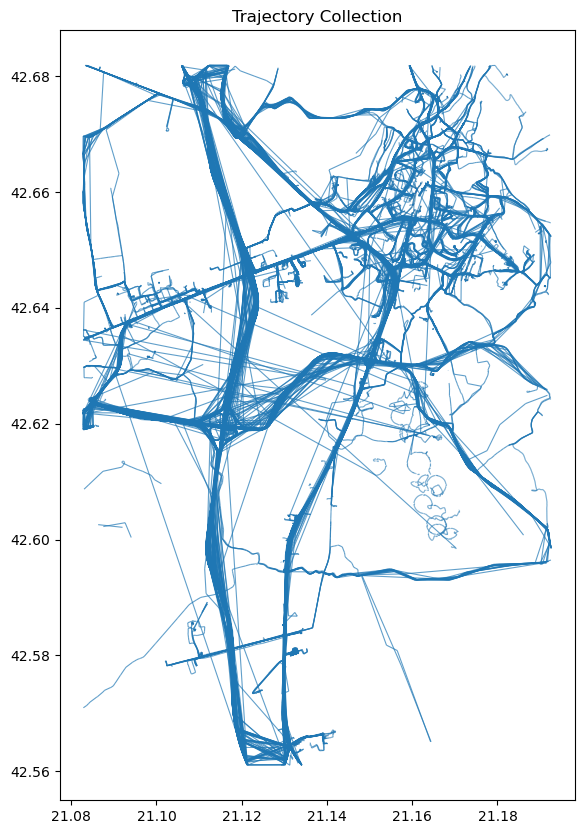

In [ ]:
import matplotlib.pyplot as plt

ax = traj_collection.plot(figsize=(10, 10), linewidth=0.8, alpha=0.7)
ax.set_title("Trajectory Collection")
plt.show()

In [19]:
traj_collection.trajectories[0]

Trajectory 0028c34d5cb73401fc71e49101b153ba (1900-01-01 14:27:16 to 1900-01-01 14:39:09) | Size: 18 | Length: 11780.2m
Bounds: (2346950.2393890023, 5246360.021069196, 2350934.519811782, 5254824.718071535)
LINESTRING (2346950.2393890023 5254214.767120233, 2346956.8183709085 5254558.125358956, 2346968.9187

In [21]:
import movingpandas as mpd
print(mpd.__version__)

0.22.4


In [ ]:
!conda install -c conda-forge movingpandas


2 channel Terms of Service accepted
Channels:
 - conda-forge
 - defaults
Platform: linux-64
Solving environment: \ 

In [23]:
for traj_id, traj in traj_collection.trajectories.items():
    # do something with traj
    print(traj)


AttributeError: 'list' object has no attribute 'items'

In [24]:
mpd.KalmanSmootherCV(traj)

AttributeError: module 'movingpandas' has no attribute 'KalmanSmootherCV'

In [20]:
from datetime import timedelta
from movingpandas import TrajectoryCollection

# Resample each trajectory individually
resampled_trajs = []
for traj in traj_collection.trajectories:
    resampled = traj.resample(timedelta(seconds=5))  # or traj.simplify(5) for spatial resampling
    resampled_trajs.append(resampled)

# Create a new TrajectoryCollection from the resampled trajectories
resampled_collection = TrajectoryCollection(resampled_trajs)

AttributeError: 'Trajectory' object has no attribute 'resample'

In [12]:
# This aggregates all trajectories into a single network graph
# 'max_distance' is how far apart two traces can be to be considered the same road
# 'min_distance' is the resolution of the final centerline
aggregator = mpd.TrajectoryCollectionAggregator(traj_collection, 
                                                 max_distance=20, 
                                                 min_distance=5, 
                                                 min_stop_duration=timedelta(seconds=60))

# Get the centerlines as a GeoDataFrame
centerlines = aggregator.get_flows_gdf()

KeyboardInterrupt: 

In [ ]:

ax = traj_collection.plot(figsize=(10, 10), linewidth=0.8, alpha=0.7)
ax.set_title("Trajectory Collection")
plt.show()

In [ ]:
nav_streets = pd.read_csv("data/Kosovo's nav streets/Kosovo.csv")
# 1. Create a GeoDataFrame
nav_streets['geometry'] = [wkt.loads(xy) for xy in nav_streets["geom"]]
gdf_nav_streets = gpd.GeoDataFrame(nav_streets, crs="EPSG:4324").drop("geom" , axis = 1) # Standard
gdf_nav_streets

,road_link_id,road_name_id,ref_node_pvid,nref_node_pvid,ref_zlevel,nref_zlevel,junctionnm,fr_spd_lim,to_spd_lim,func_class,dir_travel,valid_unnamed,st_name,geometry
0,2622208760,9.946372e+09,1037854378,1037854382,0,0,N,50,50,5,B,N,Rruga Aleksandër Stipqeviq,"LINESTRING (21.12237 42.52561, 21.12199 42.52653)"
1,5641967128,4.464591e+09,997584679,1042630724,0,0,N,50,50,5,B,N,Rruga Miradi e Epërme,"LINESTRING (21.08842 42.60349, 21.08812 42.60359)"
2,2643484915,2.552547e+09,958330689,958330687,0,0,N,50,50,4,B,N,Улица Петра Бојовића,"LINESTRING (21.13104 42.59443, 21.13115 42.59444)"
3,2622190006,9.946486e+09,1037822557,1037822551,0,0,N,50,50,5,B,N,Rruga Sadik Shala,"LINESTRING (21.13396 42.52854, 21.13421 42.52864)"
4,4464591361,4.464591e+09,957663734,957663732,0,0,N,80,80,5,B,N,Rruga Miradi e Epërme,"LINESTRING (21.098 42.59523, 21.09754 42.59511..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4348,10939790827,NaN,1269653529,1269653531,0,0,N,30,30,5,B,Y,NaN,"LINESTRING (21.13794 42.61351, 21.13763 42.613..."
4349,10953506032,NaN,1270273248,1270273249,0,0,N,50,0,5,F,Y,NaN,"LINESTRING (21.08466 42.60346, 21.0846 42.6034..."
4350,10953506030,NaN,1270273246,1270273248,0,0,N,50,0,5,F,Y,NaN,"LINESTRING (21.08468 42.60339, 21.08468 42.603..."
4351,10953506031,NaN,1270273247,1270273249,0,0,N,0,50,5,T,Y,NaN,"LINESTRING (21.08441 42.60336, 21.0844 42.6034..."


<Axes: >

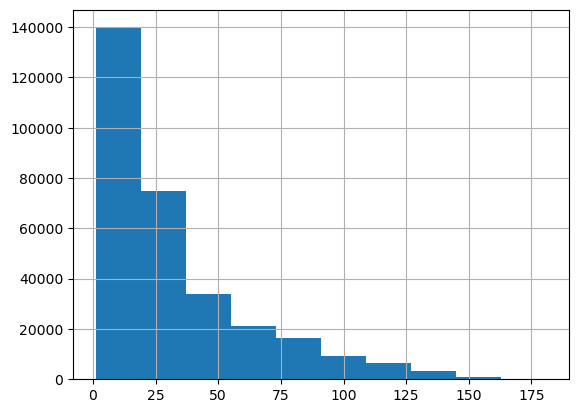

In [ ]:
prob_data["speed"].hist()

In [ ]:
prob_data.groupby("traceid")["time"].diff().mean().total_seconds()

4.616399

In [ ]:
import matplotlib.pyplot as plt

ax = traj_collection.plot(figsize=(10, 10), linewidth=0.8, alpha=0.7)
ax.set_title("Trajectory Collection")
plt.show()